# PU learning techniques applied to synthetic data

In [ ]:
!pip install --user pulearn shap

In [ ]:
!pip install --user numba==0.52.0 umap-learn==0.5.1

In [43]:
import pandas as pd                    # for data handling
import numpy as np                     # for random selections, mainly
import matplotlib.pyplot as plt        # for plotting
import plotly.io as pio
import shap
import time
pio.renderers.default = "png"
%matplotlib inline                  
plt.rcParams['figure.figsize'] = 12,12 # graph dimensions
plt.rcParams['font.size'] = 14         # graph font size

In [2]:
from sklearn.datasets import make_classification

smp_val = 1000
rand_val = 42

X, y = make_classification(
    n_samples=10000, 
    n_features=15,
    random_state=rand_val,
    flip_y=0.05 # The fraction of samples whose class is assigned randomly. 
                # Larger values introduce noise in the labels and make the classification task harder.
)

In [3]:
# helper function to create feature column names depending on the number of features generated
def featGen(X):
    feat_lst = []
    
    # if ndarray type
    if type(X).__module__ == np.__name__:
        for ct in range(len(X[0])):
            feat_lst.append(f'feature_{ct + 1}')
            
    # if dataframe
    else:
        for ct in range(len(X.columns)):
            feat_lst.append(f'feature_{ct + 1}')
        
    return feat_lst

In [4]:
start_time = time.time()

X = pd.DataFrame(X, columns=featGen(X))
y = pd.Series(y)

# display feature columns and true labels
print(display(X))
print(f'\n{display(y)}')
print(f'\nUnique classes: {y.unique()}')
print('\nDone. Time elapsed: {:.2f}s'.format(time.time() - start_time))

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15
0,0.696258,0.880328,-0.267697,0.624397,-1.170869,0.902228,-1.343636,-0.366226,1.056791,1.231026,-1.541987,-0.762140,-0.075257,-0.324040,0.478896
1,-2.429293,-0.971495,0.723096,-0.661740,-1.077013,-1.049546,-0.180245,0.614307,-0.160102,0.650384,0.164843,-1.113809,0.970249,0.540457,0.951070
2,-0.271132,-1.916275,-0.737864,-1.514811,-0.718693,-0.294512,1.775445,0.942432,-0.141197,-0.012332,2.294426,-1.170274,-1.879227,-0.595257,-0.536138
3,0.596305,1.101441,-0.094236,-1.366793,1.065911,-0.089221,-0.190220,-0.646614,-0.815437,-0.371339,-0.551524,-0.851562,0.039805,-0.261250,0.055125
4,0.831115,-1.037868,-1.641580,0.924373,0.839483,-0.404175,-2.262456,0.917847,1.103906,-0.406339,-1.736722,0.815034,-0.782830,-0.146974,0.491897
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,1.730478,0.692875,2.770137,0.938525,0.307120,2.173091,0.624200,-0.500761,0.175931,-0.878716,0.340470,0.409285,-2.147579,1.528543,-0.048678
9996,0.312908,-0.390361,-0.884954,0.261766,-1.289052,1.409093,0.319694,0.197286,0.285723,-0.431007,0.428600,0.241574,0.719371,-1.296924,0.241062
9997,0.927425,-0.434406,1.247112,0.355968,-0.202518,-0.891903,-0.322668,0.305279,-0.759397,0.289146,-0.149993,-1.196979,-0.028375,-0.424238,-0.422009
9998,0.588281,1.390007,2.350994,0.082298,1.580982,-0.895769,1.495152,-1.035297,-2.467881,-0.094192,0.907517,0.280219,0.947293,-0.303793,1.721656


None


0       0
1       0
2       1
3       0
4       0
       ..
9995    1
9996    1
9997    1
9998    1
9999    1
Length: 10000, dtype: int32


None

Unique classes: [0 1]

Done. Time elapsed: 0.03s


In [5]:
# Check the contents of the set
print('\n%d data points and %d features\n' % (X.shape))
print(pd.Series(y).value_counts())


10000 data points and 15 features

0    5025
1    4975
dtype: int64


## Init main dataframe
---

In [6]:
df = pd.DataFrame()
df = pd.concat([X])
df['target'] = y
df

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,target
0,0.696258,0.880328,-0.267697,0.624397,-1.170869,0.902228,-1.343636,-0.366226,1.056791,1.231026,-1.541987,-0.762140,-0.075257,-0.324040,0.478896,0
1,-2.429293,-0.971495,0.723096,-0.661740,-1.077013,-1.049546,-0.180245,0.614307,-0.160102,0.650384,0.164843,-1.113809,0.970249,0.540457,0.951070,0
2,-0.271132,-1.916275,-0.737864,-1.514811,-0.718693,-0.294512,1.775445,0.942432,-0.141197,-0.012332,2.294426,-1.170274,-1.879227,-0.595257,-0.536138,1
3,0.596305,1.101441,-0.094236,-1.366793,1.065911,-0.089221,-0.190220,-0.646614,-0.815437,-0.371339,-0.551524,-0.851562,0.039805,-0.261250,0.055125,0
4,0.831115,-1.037868,-1.641580,0.924373,0.839483,-0.404175,-2.262456,0.917847,1.103906,-0.406339,-1.736722,0.815034,-0.782830,-0.146974,0.491897,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,1.730478,0.692875,2.770137,0.938525,0.307120,2.173091,0.624200,-0.500761,0.175931,-0.878716,0.340470,0.409285,-2.147579,1.528543,-0.048678,1
9996,0.312908,-0.390361,-0.884954,0.261766,-1.289052,1.409093,0.319694,0.197286,0.285723,-0.431007,0.428600,0.241574,0.719371,-1.296924,0.241062,1
9997,0.927425,-0.434406,1.247112,0.355968,-0.202518,-0.891903,-0.322668,0.305279,-0.759397,0.289146,-0.149993,-1.196979,-0.028375,-0.424238,-0.422009,1
9998,0.588281,1.390007,2.350994,0.082298,1.580982,-0.895769,1.495152,-1.035297,-2.467881,-0.094192,0.907517,0.280219,0.947293,-0.303793,1.721656,1


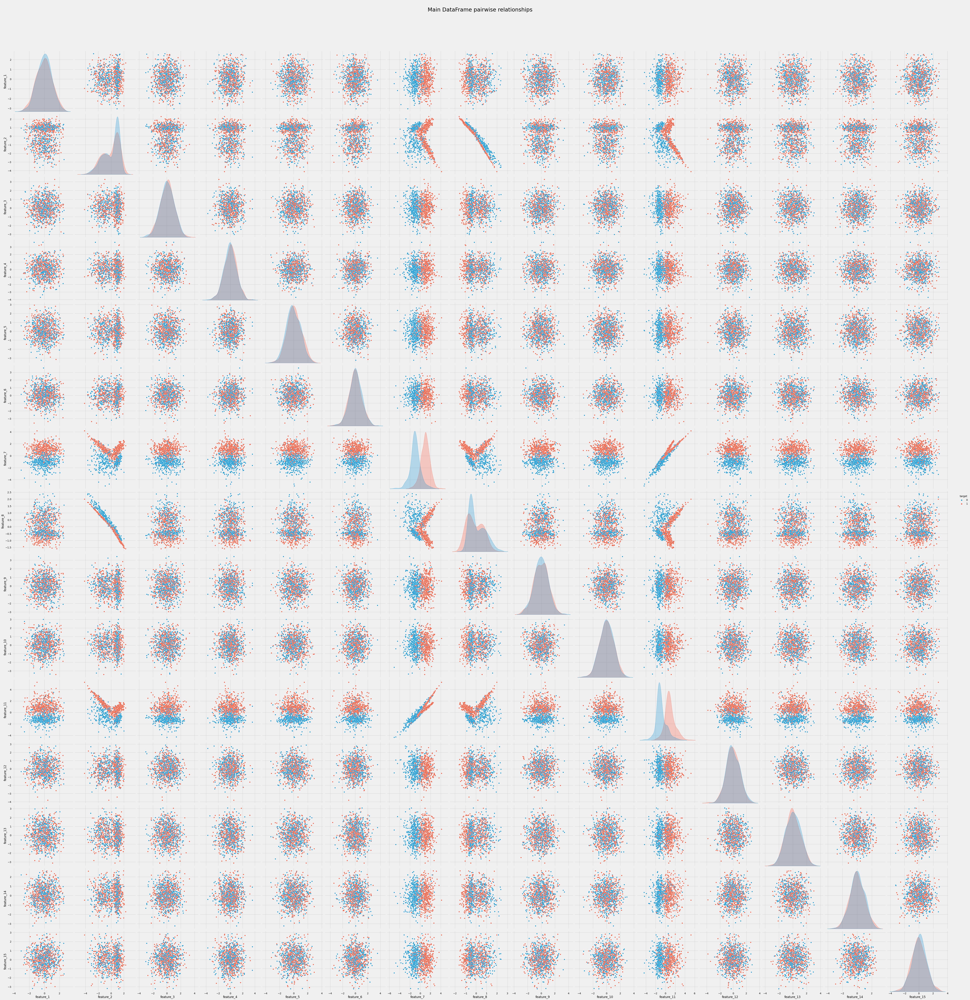

In [7]:
import seaborn as sns

plt.style.use('fivethirtyeight')

# helper function for plotting a pairplot
def plotPair(df, title):
    g = sns.pairplot(df.sample(smp_val, random_state=rand_val), height=5, diag_kind='kde', hue='target')
    g.fig.suptitle(f'\n{title}', fontsize=30, y=1.04)
    plt.show()
    
plotPair(df, 'Main DataFrame pairwise relationships')

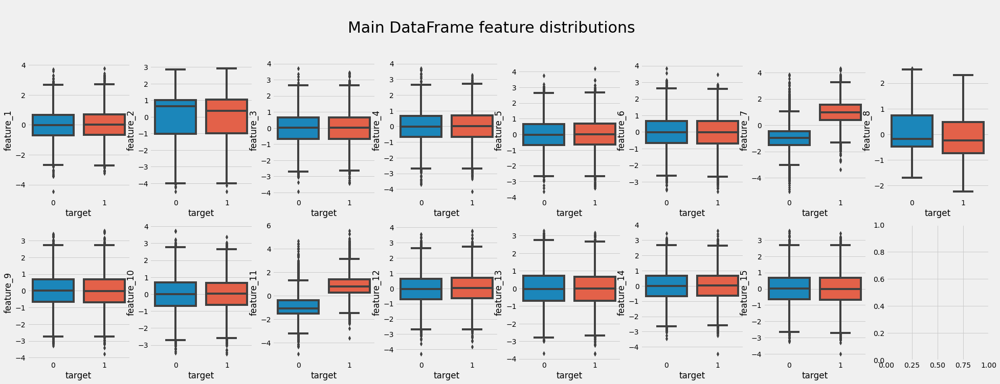

In [8]:
# helper function for plotting boxplots
def plotBox(df, title):
    X = df.drop(['target'], axis=1)
    y = df['target']

    X_len = len(X.columns)
    chk = X_len % 2
    row_val = 1
    
    if X_len > 5:
        col_val = X_len // 2
        row_val += 1
        if chk == 1:
            col_val += 1
    else:
        col_val = X_len

    fig, axes = plt.subplots(row_val, col_val, figsize=(30, 10))
    fig.suptitle(f'\n{title}', fontsize=30, y=1.04)

    # for indexing
    ctr = 0

    for i in range(row_val):
        for j in range(col_val):
            if row_val > 1:
                sns.boxplot(ax=axes[i,j], data=df, x='target', y=X.columns[ctr])
                if ctr + 1 != X_len:
                    ctr += 1
                else:
                    break;
            else:
                sns.boxplot(ax=axes[j], data=df, x='target', y=X.columns[ctr])
                ctr += 1
        
plotBox(df, 'Main DataFrame feature distributions')

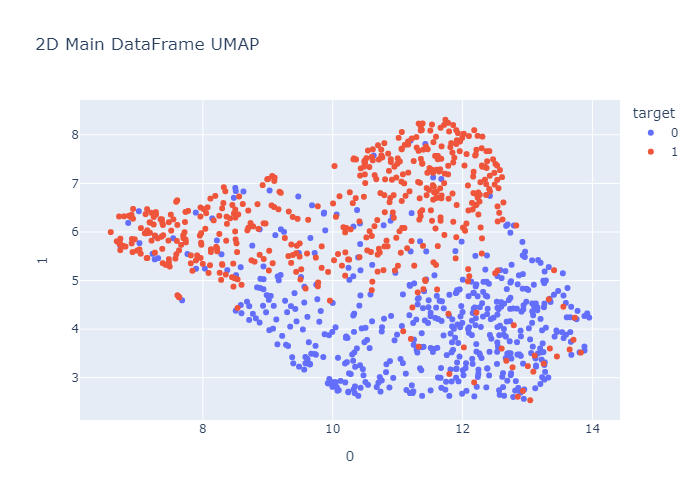


Done. Time elapsed: 28.42s


In [9]:
import plotly.express as px
import matplotlib.colors as mcolors
from sklearn.manifold import TSNE
from itertools import cycle
from umap.umap_ import UMAP

# helper function for projecting a UMAP plot
def plotUMAP(df, title, target=None, color=None):
    start_time = time.time()

    if target is None:
        test = df.sample(smp_val, random_state=rand_val)
        features = test[X.columns]
    else:
        if color is None:
            test = df.sample(smp_val, random_state=rand_val)
            temp = test.drop([target], axis=1)
        #     features = test[featGen(X)]
            features = test[temp.columns]
        else:
            test = df.sample(smp_val, random_state=rand_val)
            features = test[X.columns]            
    
    # Topic colors
    mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])
    
    # sets color to 'target' parameter if 'color' parameter wasn't provided
    if color is None:
        color = mycolors[test[target]]
        label = test[target]
    else:
        color = test[color]
        label = color

#     tsne_model = TSNE(n_components=2, random_state=rand_val)
#     projections = tsne_model.fit_transform(features)
    umap_2d = UMAP(n_components=2, random_state=rand_val)
    proj_2d = umap_2d.fit_transform(features)

    fig = px.scatter(
        proj_2d, x=0, y=1, 
        color=color,
        labels={'color': 'target'},
        title=f'2D {title} UMAP'
    )

    labels = cycle(set(label))

    fig.for_each_trace(lambda t:  t.update(name = next(labels)))
    # fig.update_layout(width=1200, height=600)
    fig.show()

    print('\nDone. Time elapsed: {:.2f}s'.format(time.time() - start_time))
    
plotUMAP(df, 'Main DataFrame', 'target')

In [10]:
print(f'\nNumber of positive samples: {sum(y==1)} ({(sum(y==1) / len(y)) * 100:.2f}%)')
print(f'Number of unlabeled samples: {sum(y==0)} ({sum(y==0) / len(y) * 100:.2f}%)\n')


Number of positive samples: 4975 (49.75%)
Number of unlabeled samples: 5025 (50.25%)



In [11]:
# Back up the true labels
y_orig = y.copy()

# Unlabel 95% of positive samples
hidden_size = int(sum(y) * 0.95)

y.loc[
    # use the 'choice' method to randomly select rows 
    np.random.choice(
        y[y==1].index,   # since 'y' is a series object, indexing is used to get the indexes of rows where 'y==1'
        replace=False,   # value of 'y[y==1].index' can't be selected multiple times
        size=hidden_size # output shape
    )
] = 0 # unlabel 'hidden_size' number of positive samples

In [12]:
# Verify the new contents of the set
print(f'\nUnlabeled {hidden_size} positive samples')
print(f'{sum(y==1)} ({(sum(y==1) / len(y)) * 100:.2f}%) remaining positive samples out of {len(y)}\n')


Unlabeled 4726 positive samples
249 (2.49%) remaining positive samples out of 10000



In [13]:
df_2 = pd.DataFrame()
df_2 = pd.concat([X])
df_2['target'] = y
df_2

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,target
0,0.696258,0.880328,-0.267697,0.624397,-1.170869,0.902228,-1.343636,-0.366226,1.056791,1.231026,-1.541987,-0.762140,-0.075257,-0.324040,0.478896,0
1,-2.429293,-0.971495,0.723096,-0.661740,-1.077013,-1.049546,-0.180245,0.614307,-0.160102,0.650384,0.164843,-1.113809,0.970249,0.540457,0.951070,0
2,-0.271132,-1.916275,-0.737864,-1.514811,-0.718693,-0.294512,1.775445,0.942432,-0.141197,-0.012332,2.294426,-1.170274,-1.879227,-0.595257,-0.536138,0
3,0.596305,1.101441,-0.094236,-1.366793,1.065911,-0.089221,-0.190220,-0.646614,-0.815437,-0.371339,-0.551524,-0.851562,0.039805,-0.261250,0.055125,0
4,0.831115,-1.037868,-1.641580,0.924373,0.839483,-0.404175,-2.262456,0.917847,1.103906,-0.406339,-1.736722,0.815034,-0.782830,-0.146974,0.491897,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,1.730478,0.692875,2.770137,0.938525,0.307120,2.173091,0.624200,-0.500761,0.175931,-0.878716,0.340470,0.409285,-2.147579,1.528543,-0.048678,0
9996,0.312908,-0.390361,-0.884954,0.261766,-1.289052,1.409093,0.319694,0.197286,0.285723,-0.431007,0.428600,0.241574,0.719371,-1.296924,0.241062,0
9997,0.927425,-0.434406,1.247112,0.355968,-0.202518,-0.891903,-0.322668,0.305279,-0.759397,0.289146,-0.149993,-1.196979,-0.028375,-0.424238,-0.422009,0
9998,0.588281,1.390007,2.350994,0.082298,1.580982,-0.895769,1.495152,-1.035297,-2.467881,-0.094192,0.907517,0.280219,0.947293,-0.303793,1.721656,0


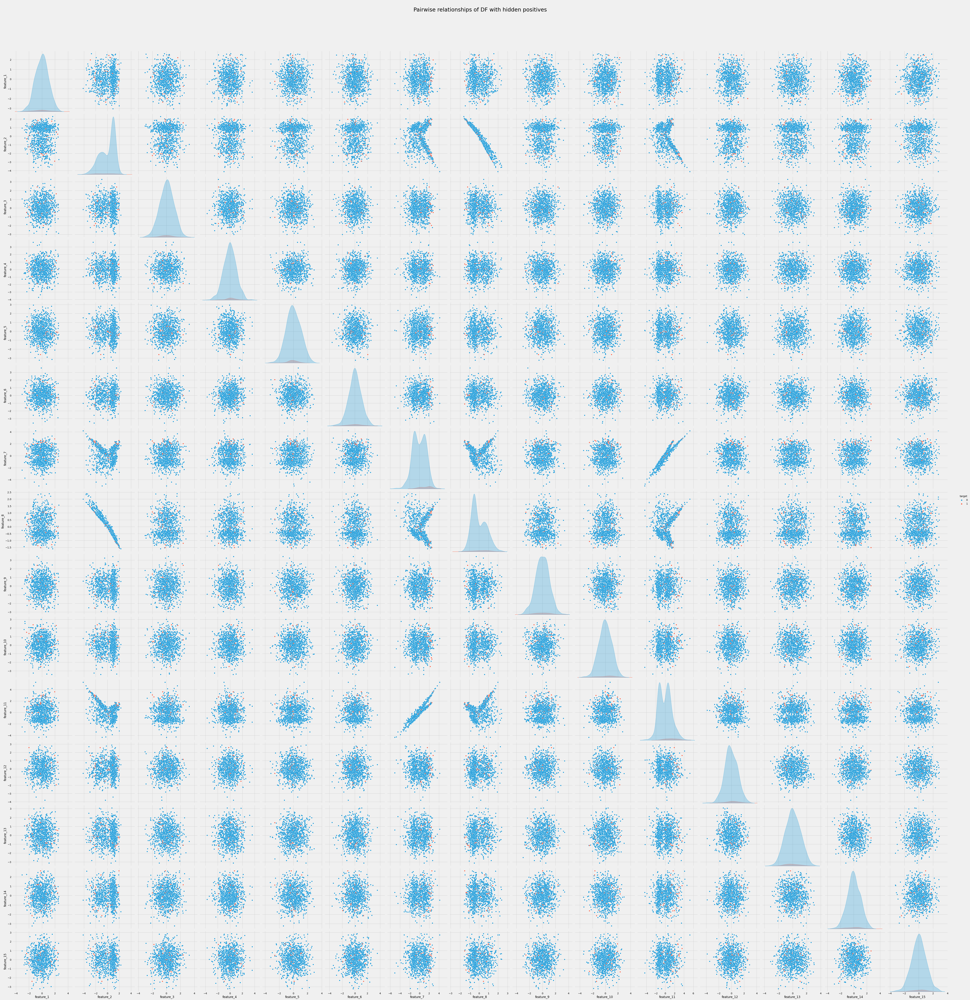

In [14]:
plotPair(df_2, 'Pairwise relationships of DF with hidden positives')

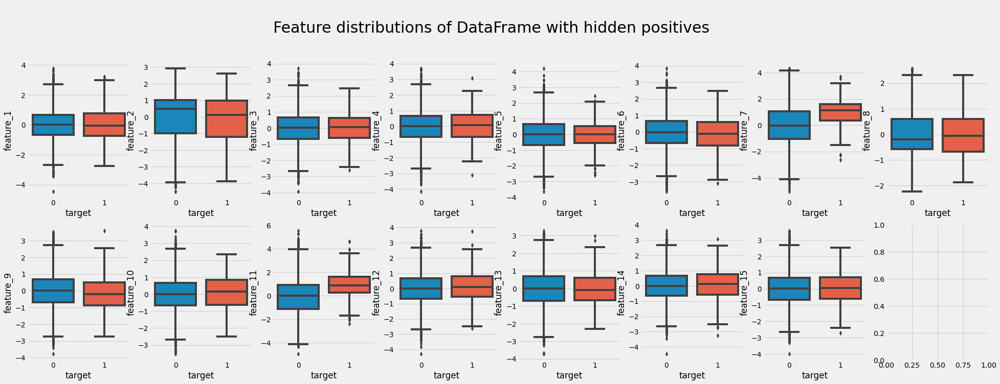

In [15]:
plotBox(df_2, 'Feature distributions of DataFrame with hidden positives')

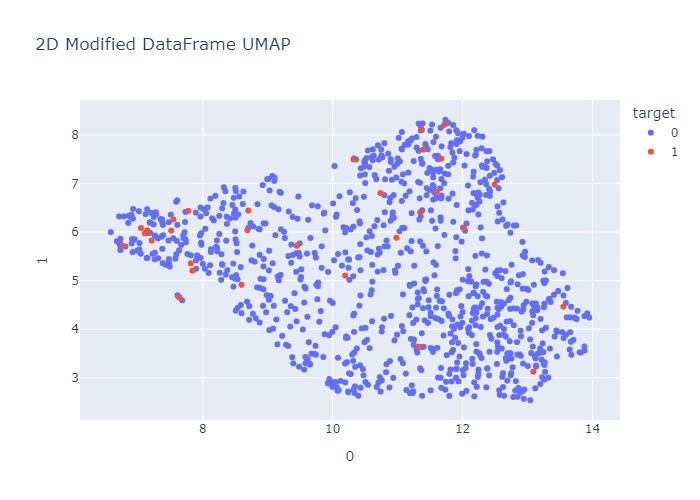


Done. Time elapsed: 3.71s


In [16]:
plotUMAP(df_2, 'Modified DataFrame', 'target')

## Standard classifier

In [17]:
from sklearn.ensemble import RandomForestClassifier

start_time = time.time()

rf = RandomForestClassifier(
    n_estimators=1000,  # Use 1000 trees
    n_jobs=-1,          # Use all CPU cores
    random_state=rand_val,
    class_weight='balanced'
)
rf.fit(X, y)

results = pd.DataFrame()
results = pd.concat([X])
results['truth'] = y_orig                         # true labels
results['label'] = y                              # labels with hidden positives
results['preds_std'] = rf.predict_proba(X)[:,1]   # The random forest's scores

print('\nDone. Time elapsed: {:.2f}s\n'.format(time.time() - start_time))
results


Done. Time elapsed: 7.80s



,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,truth,label,preds_std
0,0.696258,0.880328,-0.267697,0.624397,-1.170869,0.902228,-1.343636,-0.366226,1.056791,1.231026,-1.541987,-0.762140,-0.075257,-0.324040,0.478896,0,0,0.001
1,-2.429293,-0.971495,0.723096,-0.661740,-1.077013,-1.049546,-0.180245,0.614307,-0.160102,0.650384,0.164843,-1.113809,0.970249,0.540457,0.951070,0,0,0.005
2,-0.271132,-1.916275,-0.737864,-1.514811,-0.718693,-0.294512,1.775445,0.942432,-0.141197,-0.012332,2.294426,-1.170274,-1.879227,-0.595257,-0.536138,1,0,0.014
3,0.596305,1.101441,-0.094236,-1.366793,1.065911,-0.089221,-0.190220,-0.646614,-0.815437,-0.371339,-0.551524,-0.851562,0.039805,-0.261250,0.055125,0,0,0.005
4,0.831115,-1.037868,-1.641580,0.924373,0.839483,-0.404175,-2.262456,0.917847,1.103906,-0.406339,-1.736722,0.815034,-0.782830,-0.146974,0.491897,0,0,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,1.730478,0.692875,2.770137,0.938525,0.307120,2.173091,0.624200,-0.500761,0.175931,-0.878716,0.340470,0.409285,-2.147579,1.528543,-0.048678,1,0,0.003
9996,0.312908,-0.390361,-0.884954,0.261766,-1.289052,1.409093,0.319694,0.197286,0.285723,-0.431007,0.428600,0.241574,0.719371,-1.296924,0.241062,1,0,0.004
9997,0.927425,-0.434406,1.247112,0.355968,-0.202518,-0.891903,-0.322668,0.305279,-0.759397,0.289146,-0.149993,-1.196979,-0.028375,-0.424238,-0.422009,1,0,0.006
9998,0.588281,1.390007,2.350994,0.082298,1.580982,-0.895769,1.495152,-1.035297,-2.467881,-0.094192,0.907517,0.280219,0.947293,-0.303793,1.721656,1,0,0.004


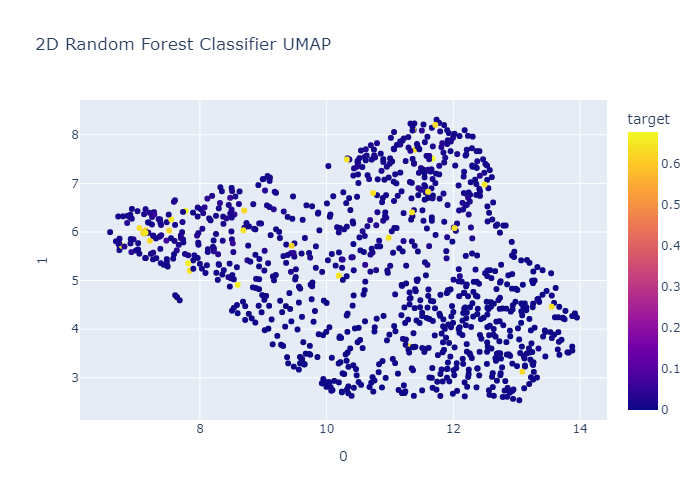


Done. Time elapsed: 3.32s


In [18]:
plotUMAP(results, 'Random Forest Classifier', 'truth', 'preds_std')

Permutation explainer: 1001it [32:58,  1.98s/it]                                                                       


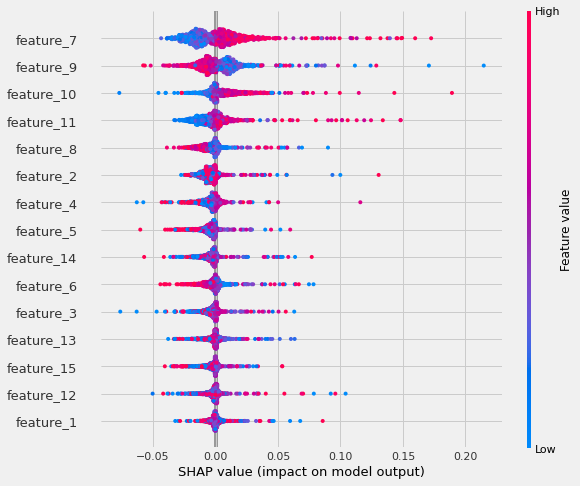

In [19]:
# helper function for plotting SHAP values
def plotSHAP(method, approach):
    if approach != 'ec':
        f = lambda x: method.predict_proba(x)[:,1]
        med = X.median().values.reshape((1, X.shape[1]))
        
        explainer = shap.Explainer(f, med)
        
        '''
        rather than use the whole training set to estimate expected values,  
        1000 samples are taken from the main dataset as a summary.
        '''
        shap_vals = explainer(X.sample(smp_val, random_state=rand_val))
        shap.summary_plot(shap_vals)
    else:
        '''
        class probabilities for the Classic Elkanoto classifier 
        only have 1 column
        '''
        start_time = time.time()
        f = lambda x: method.predict_proba(x)
        med = X.median().values.reshape((1, X.shape[1]))
        
        explainer = shap.Explainer(f, med)
        
        shap_vals = explainer(X.sample(smp_val, random_state=rand_val))
        shap.summary_plot(shap_vals)
        print('\nDone. Time elapsed: {:.2f}s\n'.format(time.time() - start_time))
    
plotSHAP(rf, 'rf')

### Using `ElkanotoPuClassifier`

In [45]:
from pulearn import ElkanotoPuClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

start_time = time.time()

# init estimator
estimator = make_pipeline(
    StandardScaler(),
    SGDClassifier(
        loss='modified_huber',
        n_jobs=-1,
        random_state=rand_val,
        class_weight='balanced'
    )
)

ec = ElkanotoPuClassifier(
    estimator,
    hold_out_ratio=0.2
)

# inputs to the fit function have to be Numpy-vectorized
ec.fit(X.values, y.values)

print('\nDone. Time elapsed: {:.2f}s'.format(time.time() - start_time))


Done. Time elapsed: 0.06s


### Extract only the 2nd column to get the predicted class probabilities on whether or not the input sample is positive

In [46]:
results['preds_ec'] = ec.predict_proba(X.values)

In [47]:
results

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,...,feature_12,feature_13,feature_14,feature_15,truth,label,preds_std,preds_ec,preds_bag,preds_mean
0,0.696258,0.880328,-0.267697,0.624397,-1.170869,0.902228,-1.343636,-0.366226,1.056791,1.231026,...,-0.762140,-0.075257,-0.324040,0.478896,0,0,0.001,0.000000,0.226,0.075667
1,-2.429293,-0.971495,0.723096,-0.661740,-1.077013,-1.049546,-0.180245,0.614307,-0.160102,0.650384,...,-1.113809,0.970249,0.540457,0.951070,0,0,0.005,0.000000,0.416,0.140333
2,-0.271132,-1.916275,-0.737864,-1.514811,-0.718693,-0.294512,1.775445,0.942432,-0.141197,-0.012332,...,-1.170274,-1.879227,-0.595257,-0.536138,1,0,0.014,1.396388,0.614,0.345856
3,0.596305,1.101441,-0.094236,-1.366793,1.065911,-0.089221,-0.190220,-0.646614,-0.815437,-0.371339,...,-0.851562,0.039805,-0.261250,0.055125,0,0,0.005,0.000000,0.351,0.118667
4,0.831115,-1.037868,-1.641580,0.924373,0.839483,-0.404175,-2.262456,0.917847,1.103906,-0.406339,...,0.815034,-0.782830,-0.146974,0.491897,0,0,0.000,0.000000,0.071,0.023667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,1.730478,0.692875,2.770137,0.938525,0.307120,2.173091,0.624200,-0.500761,0.175931,-0.878716,...,0.409285,-2.147579,1.528543,-0.048678,1,0,0.003,1.396388,0.454,1.011879
9996,0.312908,-0.390361,-0.884954,0.261766,-1.289052,1.409093,0.319694,0.197286,0.285723,-0.431007,...,0.241574,0.719371,-1.296924,0.241062,1,0,0.004,1.396388,0.423,1.001879
9997,0.927425,-0.434406,1.247112,0.355968,-0.202518,-0.891903,-0.322668,0.305279,-0.759397,0.289146,...,-1.196979,-0.028375,-0.424238,-0.422009,1,0,0.006,1.396388,0.459,1.014546
9998,0.588281,1.390007,2.350994,0.082298,1.580982,-0.895769,1.495152,-1.035297,-2.467881,-0.094192,...,0.280219,0.947293,-0.303793,1.721656,1,0,0.004,1.396388,0.535,1.039212


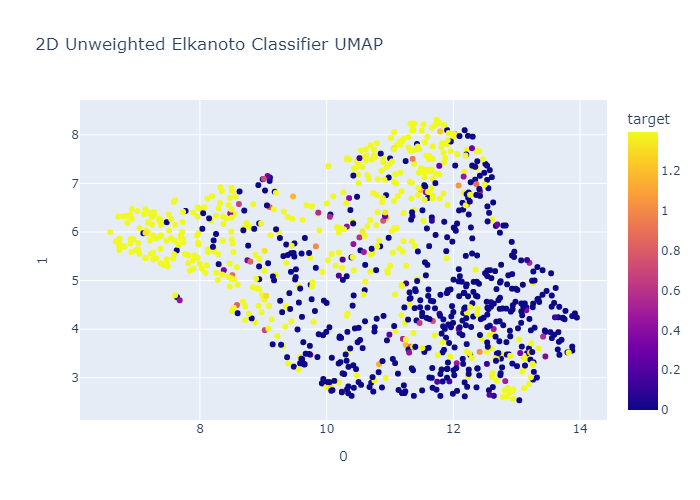


Done. Time elapsed: 3.18s


In [48]:
plotUMAP(results, 'Unweighted Elkanoto Classifier', 'truth', 'preds_ec')

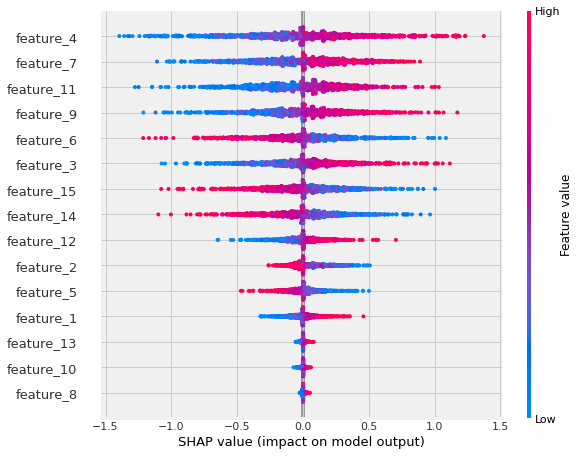


Done. Time elapsed: 4.37s



In [49]:
plotSHAP(ec, 'ec')

### Using `BaggingPuClassifier`

In [25]:
from pulearn import BaggingPuClassifier

start_time = time.time()

bc = BaggingPuClassifier(
    n_estimators=1000,  # 1000 trees as usual
    max_samples=sum(y), # Balance the positives and unlabeled in each bag
    n_jobs=-1,          # Use all cores
    random_state=rand_val
)
bc.fit(X, y)

print('\nDone. Time elapsed: {:.2f}s'.format(time.time() - start_time))


Done. Time elapsed: 34.41s


### Extract only the 2nd column to get the predicted class probabilities on whether or not the input sample is unlabeled

In [26]:
results['preds_bag'] = bc.predict_proba(X)[:,1]

In [27]:
results

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,truth,label,preds_std,preds_ec,preds_bag
0,0.696258,0.880328,-0.267697,0.624397,-1.170869,0.902228,-1.343636,-0.366226,1.056791,1.231026,-1.541987,-0.762140,-0.075257,-0.324040,0.478896,0,0,0.001,0.000000,0.226
1,-2.429293,-0.971495,0.723096,-0.661740,-1.077013,-1.049546,-0.180245,0.614307,-0.160102,0.650384,0.164843,-1.113809,0.970249,0.540457,0.951070,0,0,0.005,0.000000,0.416
2,-0.271132,-1.916275,-0.737864,-1.514811,-0.718693,-0.294512,1.775445,0.942432,-0.141197,-0.012332,2.294426,-1.170274,-1.879227,-0.595257,-0.536138,1,0,0.014,0.409567,0.614
3,0.596305,1.101441,-0.094236,-1.366793,1.065911,-0.089221,-0.190220,-0.646614,-0.815437,-0.371339,-0.551524,-0.851562,0.039805,-0.261250,0.055125,0,0,0.005,0.000000,0.351
4,0.831115,-1.037868,-1.641580,0.924373,0.839483,-0.404175,-2.262456,0.917847,1.103906,-0.406339,-1.736722,0.815034,-0.782830,-0.146974,0.491897,0,0,0.000,0.000000,0.071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,1.730478,0.692875,2.770137,0.938525,0.307120,2.173091,0.624200,-0.500761,0.175931,-0.878716,0.340470,0.409285,-2.147579,1.528543,-0.048678,1,0,0.003,2.578637,0.454
9996,0.312908,-0.390361,-0.884954,0.261766,-1.289052,1.409093,0.319694,0.197286,0.285723,-0.431007,0.428600,0.241574,0.719371,-1.296924,0.241062,1,0,0.004,2.578637,0.423
9997,0.927425,-0.434406,1.247112,0.355968,-0.202518,-0.891903,-0.322668,0.305279,-0.759397,0.289146,-0.149993,-1.196979,-0.028375,-0.424238,-0.422009,1,0,0.006,2.578637,0.459
9998,0.588281,1.390007,2.350994,0.082298,1.580982,-0.895769,1.495152,-1.035297,-2.467881,-0.094192,0.907517,0.280219,0.947293,-0.303793,1.721656,1,0,0.004,2.578637,0.535


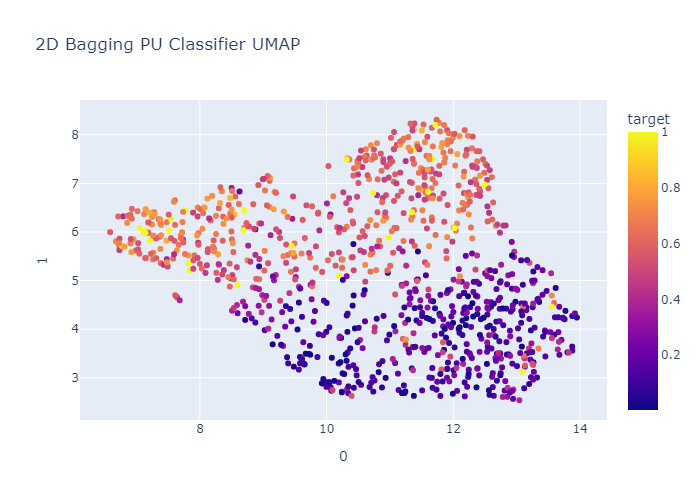


Done. Time elapsed: 3.36s


In [28]:
plotUMAP(results, 'Bagging PU Classifier', 'truth', 'preds_bag')

Permutation explainer: 1001it [1:25:39,  5.14s/it]                                                                     


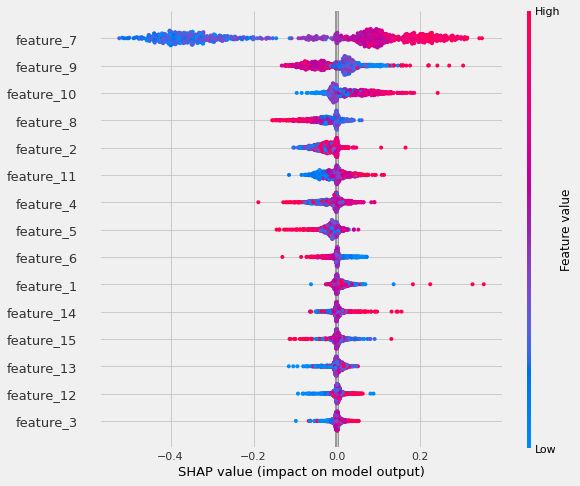

In [29]:
plotSHAP(bc, 'bc')

## Model evaluation
---


RF Classifier
  Best Threshold=0.0060
  G-Mean=0.8332

Classic Elkanoto
  Best Threshold=0.0366
  G-Mean=0.5529

PU Bagging
  Best Threshold=0.4470
  G-Mean=0.8660



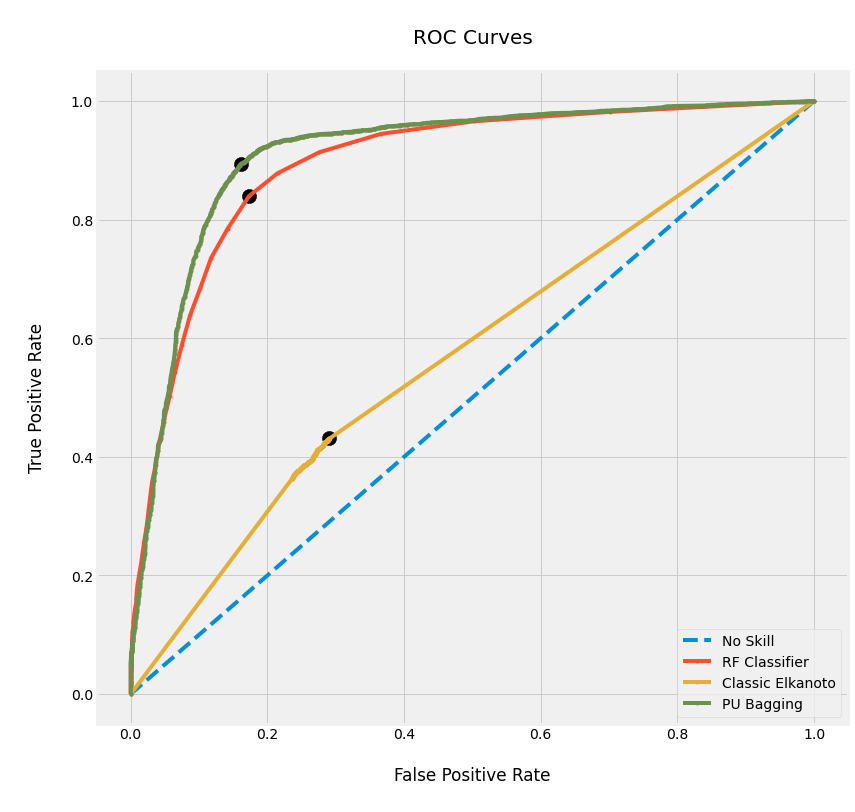

In [44]:
from sklearn.metrics import roc_curve
from numpy import sqrt, argmax

# init DF and lists
roc_df = pd.DataFrame()
title_lst = []
fpr_lst = []
tpr_lst = []
ix_lst = []
threshold_lst = []

# helper function for calculating ROC curve and G-Means
def rocCurves(method, title):
    # calculate roc curves
    fpr, tpr, thresholds = roc_curve(y_orig, results[method])    
    
    '''
    The Geometric Mean or G-Mean is a metric for imbalanced classification that, 
    if optimized, will seek a balance between the sensitivity and the specificity.

    NOTE: G-Mean = sqrt(Sensitivity * Specificity)
    '''
    # calculate the g-mean for each threshold
    gmeans = sqrt(tpr * (1-fpr))
    
    # locate the index of the largest g-mean
    ix = argmax(gmeans)
    
    # store best threshold value
    best_th = thresholds[ix]
    
    print(f'\n{title}\n  Best Threshold={best_th:.4f}\n  G-Mean={gmeans[ix]:.4f}')
    
    # append values to their corresponding list
    title_lst.append(title)
    fpr_lst.append(fpr)
    tpr_lst.append(tpr)
    ix_lst.append(ix)
    threshold_lst.append(best_th)
        
def plotROC(df):
   # placeholder values for array indexing
    title = [0, 1, 2]
    fpr = [0, 1, 2]
    tpr = [0, 1, 2]
    ix = [0, 1, 2]

    for i in roc_df.index:
        title[i] = roc_df.iloc[i].title
        fpr[i] = roc_df.iloc[i].fpr
        tpr[i] = roc_df.iloc[i].tpr
        ix[i] = roc_df.iloc[i].ix
        
    print() # newline
    
    # plot the roc curves for each model
    plt.plot([0,1], [0,1], linestyle='dashed', label='No Skill')
    plt.plot(fpr[0], tpr[0], marker='.', label=title[0])
    plt.plot(fpr[1], tpr[1], marker='.', label=title[1])
    plt.plot(fpr[2], tpr[2], marker='.', label=title[2])
    plt.scatter(fpr[0][ix[0]], tpr[0][ix[0]], marker='o', color='black', s=200)
    plt.scatter(fpr[1][ix[1]], tpr[1][ix[1]], marker='o', color='black', s=200)
    plt.scatter(fpr[2][ix[2]], tpr[2][ix[2]], marker='o', color='black', s=200)

    # axis labels
    plt.xlabel('\nFalse Positive Rate\n')
    plt.ylabel('\nTrue Positive Rate\n')
    plt.legend()

    # show the plot
    plt.title('\nROC Curves\n', fontsize=20)
    plt.grid(True)
    plt.show()
    
rocCurves('preds_std', 'RF Classifier')
rocCurves('preds_ec', 'Classic Elkanoto')
rocCurves('preds_bag', 'PU Bagging')

# store lists in the DF
roc_df['title'] = title_lst
roc_df['fpr'] = fpr_lst
roc_df['tpr'] = tpr_lst
roc_df['ix'] = ix_lst
roc_df['threshold'] = threshold_lst

plotROC(roc_df)

## Comparison of approaches

In [31]:
roc_df

,title,fpr,tpr,ix,threshold
0,RF Classifier,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.00020100502512562814, 0.00180904522613...",125,0.006000
1,Classic Elkanoto,"[0.0, 0.23582089552238805, 0.23621890547263683...","[0.0, 0.3628140703517588, 0.3628140703517588, ...",297,0.036642
2,PU Bagging,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.000...","[0.0, 0.05005025125628141, 0.05105527638190955...",374,0.447000


In [32]:
roc_df.iloc[:3].threshold

0    0.006000
1    0.036642
2    0.447000
Name: threshold, dtype: float64

In [33]:
results[['preds_std', 'preds_ec', 'preds_bag']][:5]

,preds_std,preds_ec,preds_bag
0,0.001,0.000000,0.226
1,0.005,0.000000,0.416
2,0.014,0.409567,0.614
3,0.005,0.000000,0.351
4,0.000,0.000000,0.071


In [34]:
# init preds DF
preds_df = pd.DataFrame()

# helper function for converting prediction probabilities to predictions
def convProbs(probs, threshold, method):
    # init empty list
    tmp_lst = []
    
    for i in probs:
        if i > threshold:
            tmp_lst.append(1)
        else:
            tmp_lst.append(0)
            
    # store in preds DF
    preds_df[method] = tmp_lst
    
convProbs(results['preds_std'], roc_df.iloc[0].threshold, 'rf_classifier')
convProbs(results['preds_ec'], roc_df.iloc[1].threshold, 'classic_ek')
convProbs(results['preds_bag'], roc_df.iloc[2].threshold, 'pu_bagging')
preds_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype
---  ------         --------------  -----
 0   rf_classifier  10000 non-null  int64
 1   classic_ek     10000 non-null  int64
 2   pu_bagging     10000 non-null  int64
dtypes: int64(3)
memory usage: 234.5 KB


In [35]:
# For each data point, calculate the average score from the three approaches
results['preds_mean'] = results[[
    'preds_std',  
    'preds_ec',
    'preds_bag'
]].mean(axis = 1)

In [36]:
results[results.label == 0].sort_values(
    'preds_std', ascending = False
).head()

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,...,feature_12,feature_13,feature_14,feature_15,truth,label,preds_std,preds_ec,preds_bag,preds_mean
1554,-0.407097,1.846978,0.458682,0.620036,0.289404,-0.833034,1.666804,-1.335231,-0.268168,-0.598698,...,0.438071,0.328087,-0.492439,0.249483,1,0,0.114,0.000000,0.866,0.326667
1790,-1.053775,0.614241,-0.396077,0.030986,-0.353814,-0.250194,1.209609,-0.526859,-0.175063,0.597680,...,0.237021,0.294709,0.183987,0.138415,1,0,0.081,0.000000,0.850,0.310333
6565,-0.001704,-2.435286,0.006217,-0.152026,0.239601,0.328824,2.665656,1.145956,-0.692887,-0.442271,...,0.428364,-0.052349,0.375804,0.316134,1,0,0.080,2.578637,0.844,1.167546
2312,0.162729,0.927596,-0.232379,-0.132953,-1.088099,-0.215125,1.158950,-0.711255,-0.025377,-0.126951,...,-0.327869,-0.515873,0.447119,-0.382275,1,0,0.077,0.000000,0.737,0.271333
217,0.115778,-1.235995,0.710243,0.004248,-0.035581,-1.563504,1.314871,0.586421,1.113992,0.844536,...,0.439520,-0.413018,0.236696,0.082295,1,0,0.073,0.000000,0.771,0.281333


In [37]:
results[results.label == 0].sort_values(
    'preds_std', ascending = True
).head()

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,...,feature_12,feature_13,feature_14,feature_15,truth,label,preds_std,preds_ec,preds_bag,preds_mean
5788,0.991288,0.596874,-0.471011,-0.686605,0.217712,-0.766689,-1.509540,-0.172669,0.542611,1.002056,...,-1.489188,-1.550634,-0.128759,-0.822247,0,0,0.0,0.0,0.051,0.017000
5220,0.355423,1.032696,1.078715,-1.007213,0.305382,0.677794,-1.144276,-0.484193,0.142503,0.353953,...,0.698406,0.940090,0.740703,2.072098,1,0,0.0,0.0,0.024,0.008000
5223,-0.798951,-1.349824,-0.733730,-2.271614,-0.621895,0.169949,-1.905574,1.062694,0.875025,1.286319,...,-0.926739,0.853746,-0.666724,1.975458,0,0,0.0,0.0,0.017,0.005667
9708,0.464791,-0.348149,-1.847598,-0.059675,1.391552,-0.355231,-3.920301,0.707387,0.915935,0.656811,...,0.488371,0.860742,-0.674567,-0.257043,0,0,0.0,0.0,0.013,0.004333
5229,-0.581521,1.014981,0.454529,-1.040341,0.996613,0.159590,-1.249263,-0.460140,1.779749,1.202068,...,0.804069,0.475970,-1.629486,0.485646,0,0,0.0,0.0,0.210,0.070000


In [38]:
results[results.label == 0].sort_values(
    'preds_bag', ascending = False
).head(100).truth.mean()

0.96

In [39]:
results[results.label == 0].sort_values(
    'preds_bag', ascending = True
).head(100).truth.mean()

0.04

In [40]:
# Prepare for graphing the performance 
# (i.e. the success in identifying hidden positives)
ts = range(100, hidden_size, 100)
y_std, y_bag, y_ec, y_stp, y_all = [], [], [], [], []

'''
Get the mean of the sorted truth column values from 
the results column that have label column values of '0'
every 100 samples.

The results DF is sorted using the prediction probabilities 
of each approach in descending order to start with the truth 
values that were identified to be the most likely to be 
positive by each approach. 

In essence, the following code segment acquires the percentage of 
hidden positives that were correctly identified per approach.
'''
start_time = time.time()

for t in ts:
    y_std.append(
        results[results.label == 0].sort_values(
            'preds_std', ascending = False
        ).head(t).truth.mean()
    )
    y_ec.append(
        results[results.label == 0].sort_values(
            'preds_ec', ascending = False
        ).head(t).truth.mean()
    )
    y_bag.append(
        results[results.label == 0].sort_values(
            'preds_bag', ascending = False
        ).head(t).truth.mean()
    )
    y_all.append(
        results[results.label == 0].sort_values(
            'preds_mean', ascending = False
        ).head(t).truth.mean()
    )
    
print('\nDone. Time elapsed: {:.2f}s\n'.format(time.time() - start_time))


Done. Time elapsed: 0.75s



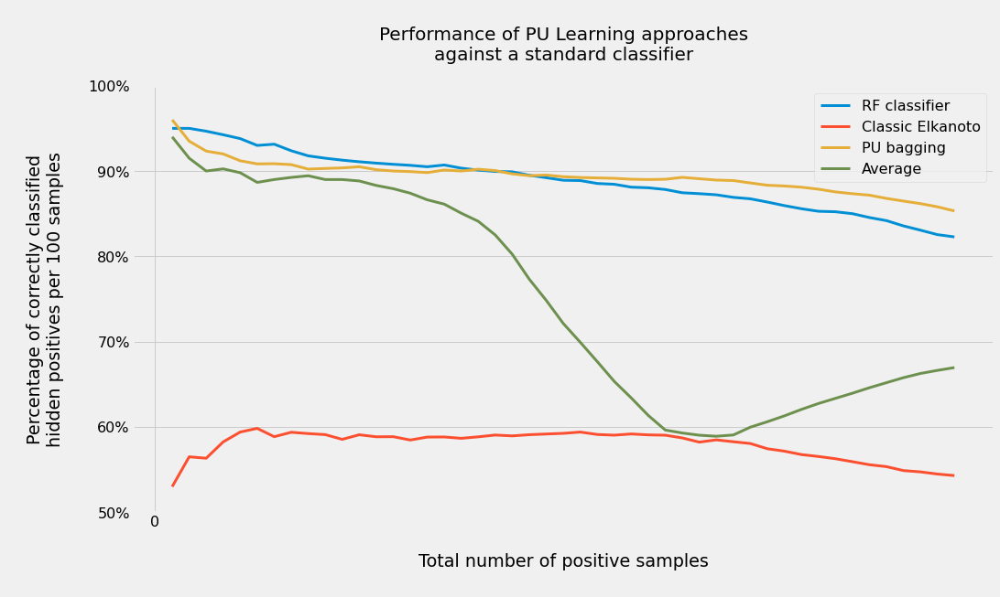

In [41]:
# Performance graphing
plt.style.use('fivethirtyeight')
plt.rcParams['font.size'] = 16
plt.rcParams['figure.figsize'] = 15, 8

plt.plot(
    ts, y_std,
    ts, y_ec,
    ts, y_bag,
    ts, y_all,
    lw = 3
)

vals = plt.gca().get_yticks()
plt.yticks(vals, ['%.0f%%' % (v*100) for v in vals])
plt.xticks(np.arange(0, max(ts)+1, 5000))
plt.xlabel('\nTotal number of positive samples\n')
plt.ylabel('\nPercentage of correctly classified\nhidden positives per 100 samples\n')
plt.legend([
    'RF classifier', 
    'Classic Elkanoto', 
    'PU bagging', 
    'Average'
])
ylim = plt.gca().get_ylim()
plt.title('\nPerformance of PU Learning approaches\nagainst a standard classifier\n', fontsize=20)
plt.grid(True)
plt.show()

In [42]:
import types
def imports():
    for name, val in globals().items():
        if isinstance(val, types.ModuleType):
            yield val.__name__
list(imports())

['builtins',
 'builtins',
 'pandas',
 'numpy',
 'matplotlib.pyplot',
 'plotly.io',
 'shap',
 'time',
 'seaborn',
 'plotly.express',
 'matplotlib.colors',
 'types']